In [205]:
import os
import pandas as pd
from PIL import Image, ImageOps, ImageChops
import random
import cv2
import numpy as np
from IPython.display import display
import re
import matplotlib.pyplot as plt
import warnings

import pytesseract
pytesseract.pytesseract.tesseract_cmd = "C:/Program Files/Tesseract-OCR/tesseract"

In [265]:
def list_images_in_folder(folder_path):
    # Supported image extensions
    image_extensions = ('.jpg', '.jpeg', '.png', '.bmp', '.tiff', '.gif')

    # Walk through the folder and list image files
    data = []
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.lower().endswith(image_extensions):
                full_path = os.path.join(root, file)
                data.append({'name': file, 'path': full_path})

    # Create DataFrame
    df = pd.DataFrame(data)
    return df

def generate_blank_scanned_canvas(dpi=300):
    # Define paper sizes in pixels at 300 DPI
    sizes = {
        'A4': (2480, 3508),
        'Letter': (2550, 3300)
    }

    # Randomly choose paper size and orientation
    paper_type = random.choice(['A4', 'Letter'])
    orientation = random.choice(['portrait', 'landscape'])

    width, height = sizes[paper_type]

    if orientation == 'landscape':
        width, height = height, width  # swap for landscape
        
    # Create a white canvas
    blank_image = Image.new("RGB", (width, height), "white")
    return blank_image

def is_overlapping(new_box, existing_boxes):
    x1_new, y1_new, x2_new, y2_new = new_box
    for x1, y1, x2, y2 in existing_boxes:
        if not (x2_new <= x1 or x1_new >= x2 or y2_new <= y1 or y1_new >= y2):
            return True  # Overlap
    return False
    
def rotate_image_randomly(image, max_degrees=5):
    angle = random.uniform(-max_degrees, max_degrees)
    return image.rotate(angle, expand=True, fillcolor="white")

def paste_image_without_overlap(canvas, image, placed_boxes, max_attempts=100):
    canvas_width, canvas_height = canvas.size
    image_width, image_height = image.size

    for _ in range(max_attempts):
        x = random.randint(0, canvas_width - image_width)
        y = random.randint(0, canvas_height - image_height)
        new_box = (x, y, x + image_width, y + image_height)

        if not is_overlapping(new_box, placed_boxes):
            canvas.paste(image, (x, y))
            placed_boxes.append(new_box)
            return canvas, placed_boxes

    # print("Warning: Couldn't find non-overlapping position.")
    return canvas, placed_boxes

def crop_with_buffer(image, buffer=30):
    # Convert the PIL image to a NumPy array for OpenCV processing
    img_cv = np.array(image)

    # Convert to grayscale
    gray = cv2.cvtColor(img_cv, cv2.COLOR_RGB2GRAY)

    # Apply binary threshold to get a black-and-white image
    _, binary = cv2.threshold(gray, 128, 255, cv2.THRESH_BINARY_INV)

    # Find contours in the binary image
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Get the bounding box for the largest contour (assuming the largest contour is the photo)
    contour = max(contours, key=cv2.contourArea)
    x, y, w, h = cv2.boundingRect(contour)

    # Add a buffer around the bounding box
    x = max(0, x - buffer)  # Ensure it doesn't go out of bounds
    y = max(0, y - buffer)
    w = min(img_cv.shape[1] - x, w + 2 * buffer)  # Ensure width doesn't go out of bounds
    h = min(img_cv.shape[0] - y, h + 2 * buffer)  # Ensure height doesn't go out of bounds

    # Crop the image with the added buffer
    cropped_with_buffer = img_cv[y:y+h, x:x+w]

    # Convert back to PIL for consistency with previous steps
    cropped_img = Image.fromarray(cropped_with_buffer)
    
    return cropped_img

def extract_photos_from_canvas(canvas_pil, buffer=30):
    # Convert PIL to OpenCV format
    canvas_cv = cv2.cvtColor(np.array(canvas_pil), cv2.COLOR_RGB2BGR)
    gray = cv2.cvtColor(canvas_cv, cv2.COLOR_BGR2GRAY)

    # Invert for better contrast with white background
    inverted = cv2.bitwise_not(gray)

    # Threshold to binary image
    _, thresh = cv2.threshold(inverted, 30, 255, cv2.THRESH_BINARY)

    # Find contours
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    crops = []
    boxes = []

    for cnt in contours:
        x, y, w, h = cv2.boundingRect(cnt)

        # Filter out very small regions (e.g., noise)
        if w > 100 and h > 100:
            # Add buffer around the crop
            x = max(0, x - buffer)
            y = max(0, y - buffer)
            w = w + 2 * buffer
            h = h + 2 * buffer

            # Ensure the crop stays within the canvas boundaries
            x2 = min(canvas_pil.width, x + w)
            y2 = min(canvas_pil.height, y + h)

            # Crop the image with the buffer
            cropped = canvas_pil.crop((x, y, x2, y2))
            crops.append(cropped)
            boxes.append((x, y, x2, y2))

    return crops, boxes

def unskew_image_NOTWORKING(img):
    img.save('tmp_img.jpg', 'JPEG')
    image = cv2.imread("tmp_img.jpg") 
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # display(array_to_PIL(gray))
    white_threshold = 253
    # Create inked image: ink = black (0), background = white (255)
    _, inked_image = cv2.threshold(gray, white_threshold, 255, cv2.THRESH_BINARY)
    # display(array_to_PIL(inked_image))
    blurred = cv2.GaussianBlur(inked_image, (5, 5), 0)
    _, spread_ink = cv2.threshold(blurred, 240, 255, cv2.THRESH_BINARY)
    # display(array_to_PIL(spread_ink))
    edges = cv2.Canny(spread_ink, 50, 150, apertureSize=7)
    # display(array_to_PIL(edges))
    # Find contours
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    # Get the largest contour (likely the photo border)
    largest = max(contours, key=cv2.contourArea)
    rect = cv2.minAreaRect(largest)  
    angle = rect[-1]
    img.rotate(90-angle)
    cropped_photos, bounding_boxes = extract_photos_from_canvas(img.rotate(90-angle), buffer=0)
    return cropped_photos[0]

def get_slice_poly(img,s="L",line_th=250,debug=False):
    slices = {
        "L":[0,img.shape[0],0,90,"v"],
        "R":[0,img.shape[0],img.shape[1]-90,img.shape[1],"v"],
        "T":[0,90,0,img.shape[1],"h"],
        "B":[img.shape[0]-90,img.shape[0],0,img.shape[1],"h"]
    }
    img_slice = img[slices[s][0]:slices[s][1],slices[s][2]:slices[s][3]]
    r, c = img_slice.shape
    if debug: display(Image.fromarray(img_slice))
    result = np.zeros((r, c), dtype=np.uint8)
    y_coords = []
    x_coords = []
    valid_count = 0
    if slices[s][4]=="v":
        for i in range(r):
            white_indices = np.where(img_slice[i] >= line_th)[0]
            if white_indices.size > 0:
                valid_count += 1
                avg_index = int(np.round(white_indices.mean()))
                if 0 <= avg_index < c:
                    result[i, avg_index] = 255
                x_coords.append(white_indices[0])  # x position
                y_coords.append(i)  # row number as y
    else:
        for j in range(c):  # iterate over columns
            white_indices = np.where(img_slice[:, j] >= line_th)[0]  # rows with white pixel in column j
            if white_indices.size > 0:
                valid_count += 1
                avg_index = int(np.round(white_indices.mean()))
                if 0 <= avg_index < r:
                    result[avg_index, j] = 255  # set the average row index
                x_coords.append(j)  # x is the column index
                y_coords.append(avg_index)  # y is the averaged row index
    if valid_count < int(0.7 * r):
        warnings.warn("No line found (not enough white pixels in scan).")
        return None, None
    x_coords = np.array(x_coords)
    y_coords = np.array(y_coords)
    m, b = np.polyfit(x_coords, y_coords, 1)
    return m,b

def angle_from_line(m,orientation="v"):
    if (m==0)|(m==None):
        warnings.warn("m cannot be 0 (no slope)")
        return None
    angle_rad = np.arctan(m)
    angle_deg = np.degrees(angle_rad)
    if orientation=="v": return angle_deg + 90  # Angle from vertical
    else: return angle_deg

def get_avg_skew_angle(img):
    df_edges = pd.DataFrame(index=["L", "R", "T", "B"], columns=["m", "b", "a"])
    for side in df_edges.index:
        m,b = get_slice_poly(img,s=side,debug=False)
        if side in ["L","R"]: o="v"
        else: o="h"
        a = angle_from_line(m,o)
        df_edges.loc[side] = [m, b, a]
    return df_edges, df_edges.loc[:,"a"].mean()

def crop_white_borders(pil_img, white_thresh=240, tighten=0.0):
    """
    Crops white borders and optionally removes an additional percentage from each edge.

    Args:
        pil_img (PIL.Image.Image): Input image.
        white_thresh (int): Threshold for what counts as white (0–255).
        tighten (float): Extra crop from each side as a fraction of cropped size (e.g. 0.1 for 10%).

    Returns:
        PIL.Image.Image: Cropped image.
    """
    if pil_img.mode != 'RGB':
        pil_img = pil_img.convert('RGB')

    img_np = np.array(pil_img)

    # Detect non-white pixels
    if len(img_np.shape) == 3:
        mask = np.any(img_np < white_thresh, axis=2)
    else:
        mask = img_np < white_thresh

    if not np.any(mask):
        return pil_img  # entire image is white

    coords = np.argwhere(mask)
    y0, x0 = coords.min(axis=0)
    y1, x1 = coords.max(axis=0) + 1

    # Apply additional tightening (fractional crop inward)
    height = y1 - y0
    width = x1 - x0

    tighten = max(0.0, min(tighten, 0.45))  # avoid overcropping

    dy = int(height * tighten)
    dx = int(width * tighten)

    y0 = min(max(0, y0 + dy), pil_img.height)
    y1 = min(max(0, y1 - dy), pil_img.height)
    x0 = min(max(0, x0 + dx), pil_img.width)
    x1 = min(max(0, x1 - dx), pil_img.width)

    # Return cropped image
    return pil_img.crop((x0, y0, x1, y1))

def treat_img(img):
    img.save('tmp_img.jpg', 'JPEG')
    image = cv2.imread("tmp_img.jpg") 
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # display(array_to_PIL(gray))
    white_threshold = 250
    # Create inked image: ink = black (0), background = white (255)
    _, inked_image = cv2.threshold(gray, white_threshold, 255, cv2.THRESH_BINARY)
    # display(array_to_PIL(inked_image))
    blurred = cv2.GaussianBlur(inked_image, (5, 5), 0)
    _, spread_ink = cv2.threshold(blurred, 240, 255, cv2.THRESH_BINARY)
    # display(array_to_PIL(spread_ink))
    edges = cv2.Canny(spread_ink, 50, 150, apertureSize=7)
    tmpDf, a = get_avg_skew_angle(np.array(edges))
    img_rotated = img.rotate(a,expand=True, fillcolor='white')
    img_rotated = crop_white_borders(img_rotated,tighten=0.02)
    return img_rotated

def array_to_PIL(image):
    return Image.fromarray(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

def plot_image_with_line(image, m, b, x0=0, y0=0, line_color='green'):
    """
    Plots a grayscale image with a line y = m*x + b overlaid in green.
    """
    r, c = image.shape
    if (m==0)|(m==None):
        warnings.warn("Cannot plot line with no slope")
        return
    # Generate x values across image width
    x_vals = np.arange(c)
    y_vals = m * (x_vals - x0) + y0

    # Plot the image
    plt.imshow(image, cmap='gray', origin='upper')

    # Overlay the line — only plot valid (on-screen) y values
    valid = (y_vals >= 0) & (y_vals < r)
    plt.plot(x_vals[valid], y_vals[valid], color=line_color, linewidth=2)
    plt.title("Image with Fitted Line")
    plt.axis('off')
    plt.show()

In [3]:
# Example usage
folder_path = "raw_pictures"  # your image folder
df_images = list_images_in_folder(folder_path)
df_images

,name,path
0,00001.jpg,raw_pictures\00001.jpg
1,00002.jpg,raw_pictures\00002.jpg
2,00003.jpg,raw_pictures\00003.jpg
3,00004.jpg,raw_pictures\00004.jpg
4,00005.jpg,raw_pictures\00005.jpg
...,...,...
1516,1988 - 001.jpg,raw_pictures\Roberto\1988 - 001.jpg
1517,1988 - 10 - Roberto e John.jpg,raw_pictures\Roberto\1988 - 10 - Roberto e Jo...
1518,1989 - 001.jpg,raw_pictures\Roberto\1989 - 001.jpg
1519,1989 - 002.jpg,raw_pictures\Roberto\1989 - 002.jpg


In [4]:
# Example usage
blank_canvas = generate_blank_scanned_canvas()
# blank_canvas.show()  # Opens the image using the default viewer
blank_canvas.size

(2480, 3508)

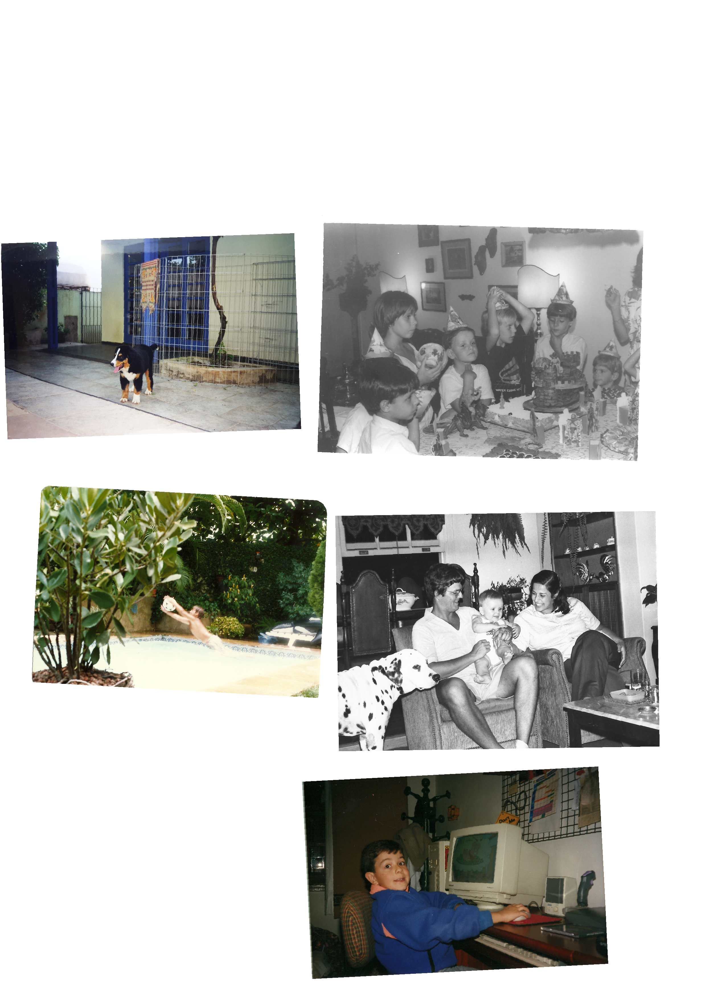

In [267]:
blank_canvas = generate_blank_scanned_canvas()
placed_boxes = []

for _ in range(5):  # Try to place 5 images
    img_path = df_images.sample(n=1)["path"].values[0]
    tmp_img = Image.open(img_path)
    tmp_resize = random.randint(768, 1152)
    tmp_img.thumbnail((tmp_resize, tmp_resize))
    tmp_img = rotate_image_randomly(tmp_img)

    blank_canvas, placed_boxes = paste_image_without_overlap(blank_canvas, tmp_img, placed_boxes)

# blank_canvas.show()
blank_canvas

In [268]:
placed_boxes

[(1103, 755, 2270, 1635),
 (1060, 2688, 2138, 3435),
 (1177, 1792, 2318, 2636),
 (2, 817, 1058, 1542),
 (107, 1701, 1157, 2449)]

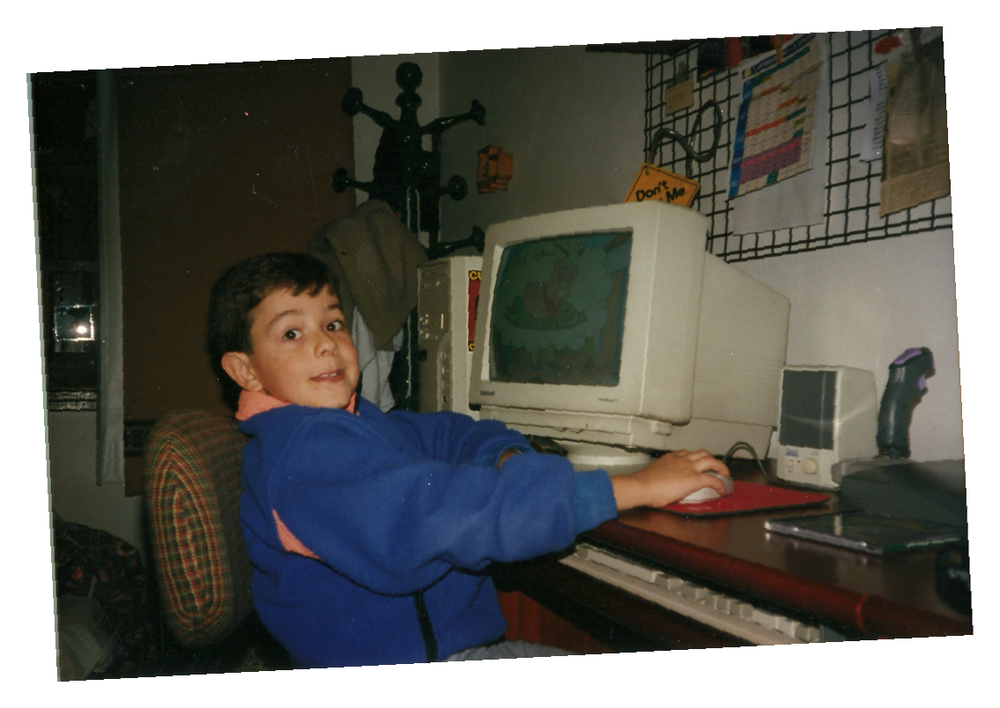

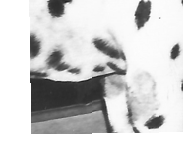

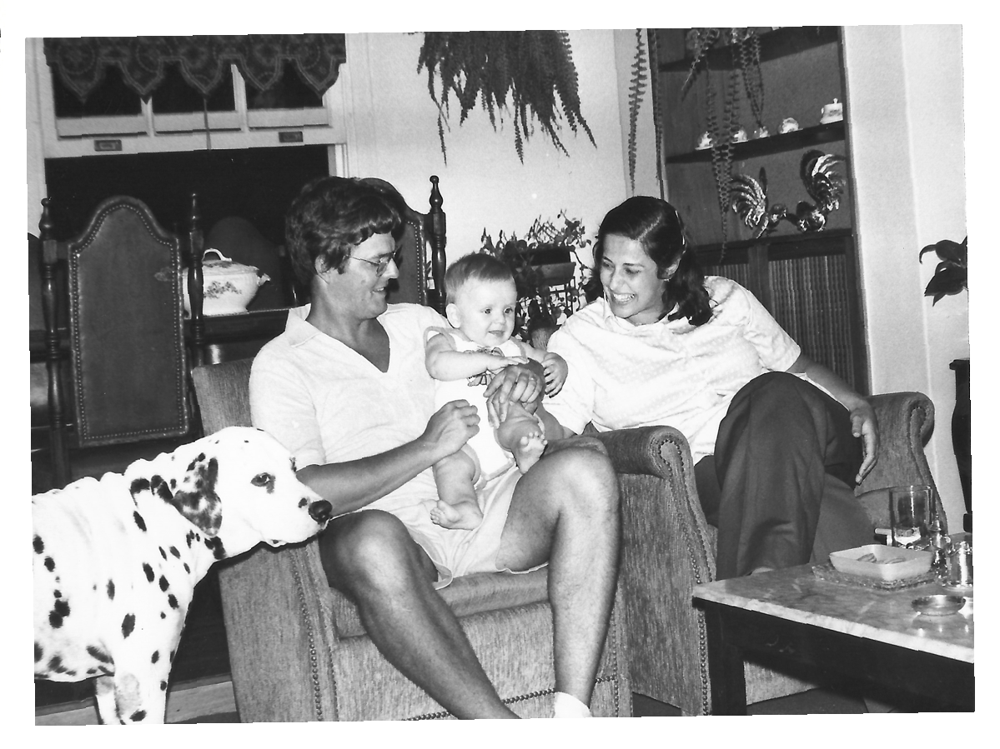

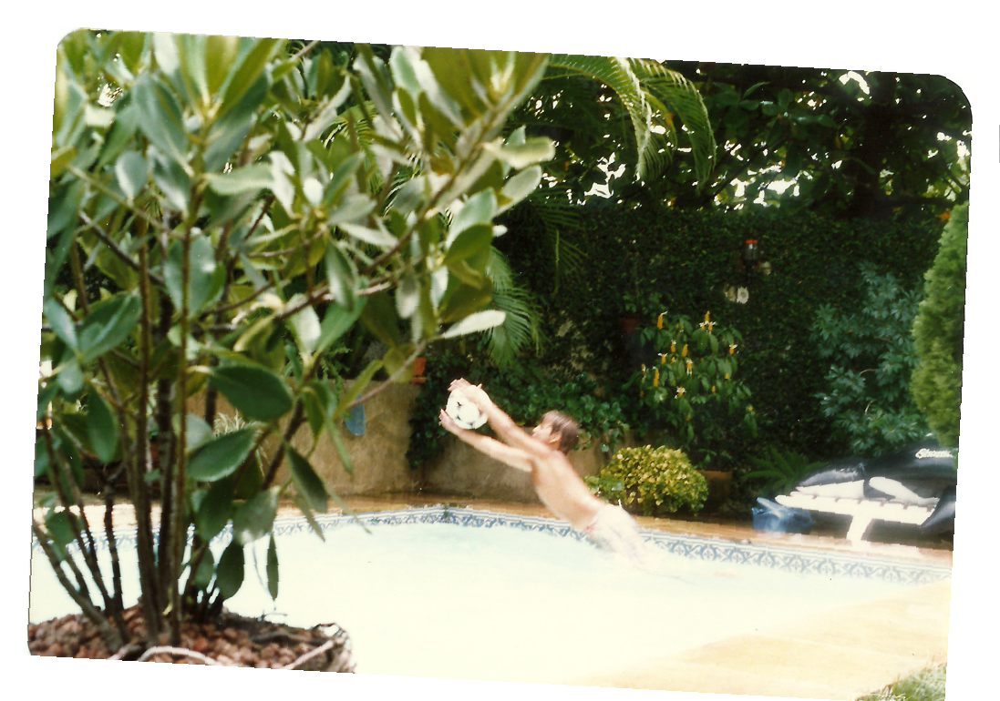

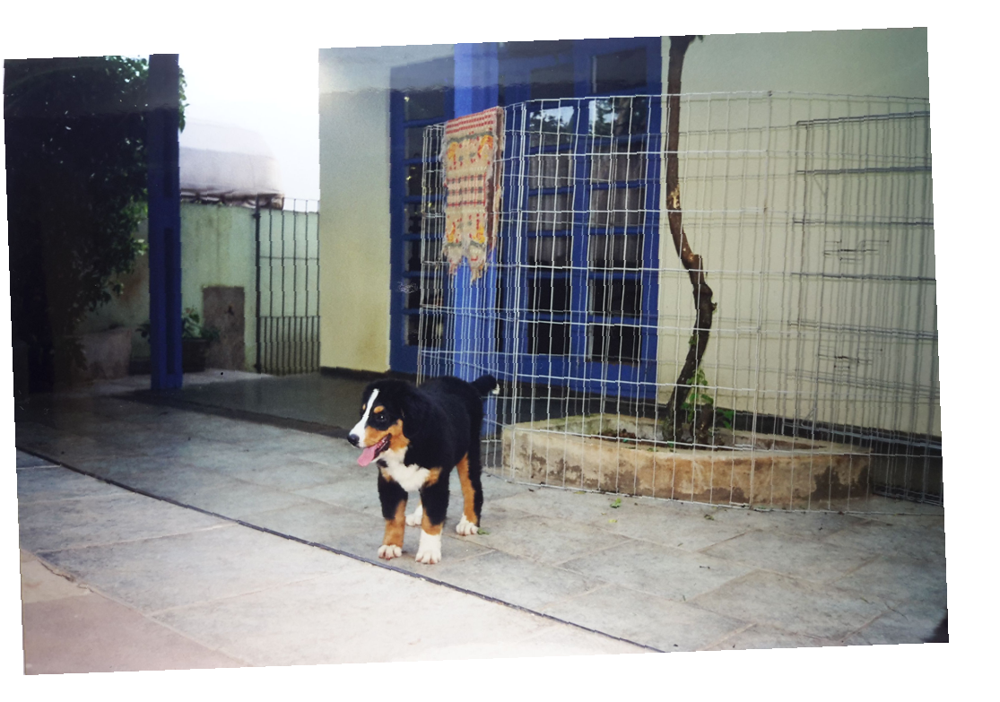

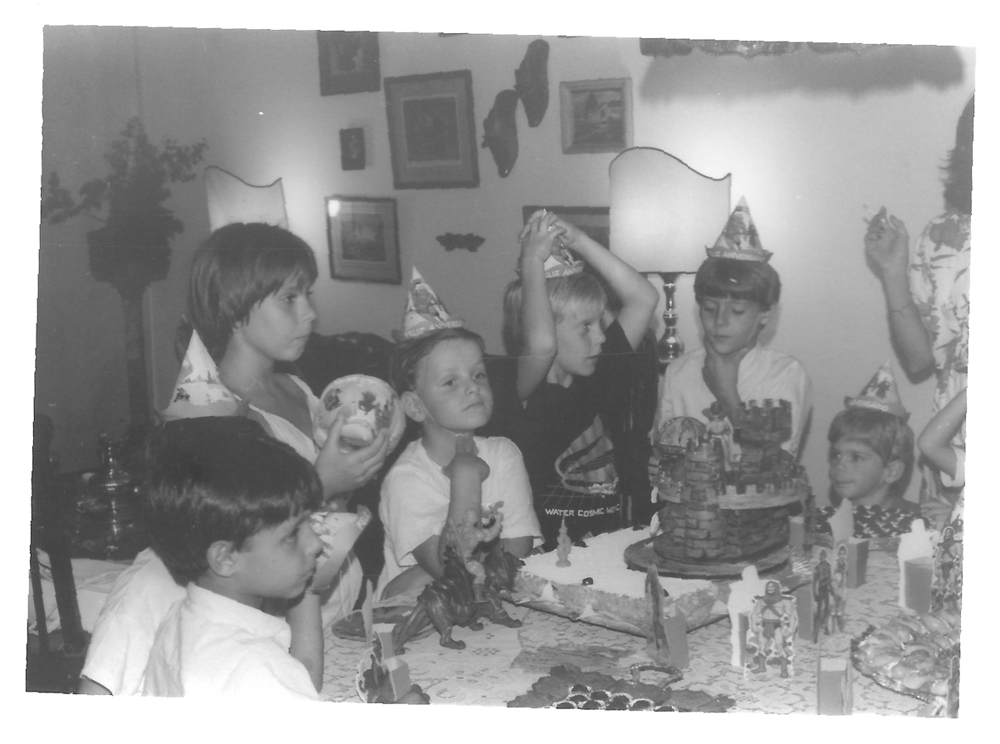

In [269]:
cropped_photos, bounding_boxes = extract_photos_from_canvas(blank_canvas, buffer=30)
for i, img in enumerate(cropped_photos):
    display(img)

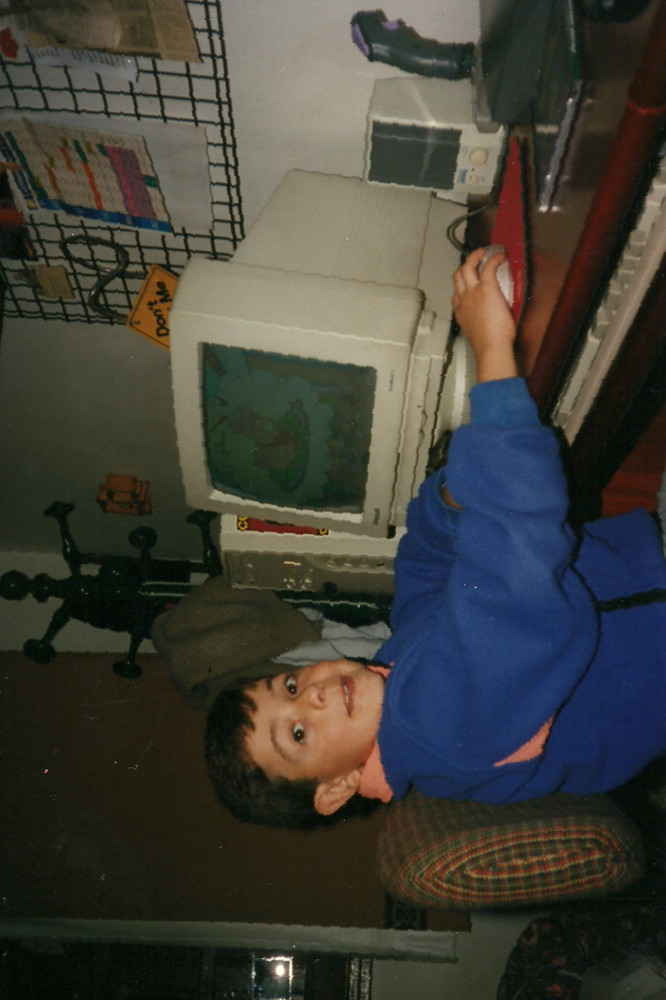

C:\Users\johnm\AppData\Local\Temp\ipykernel_25800\3275956777.py:194: UserWarning: No line found (not enough white pixels in scan).
  warnings.warn("No line found (not enough white pixels in scan).")
C:\Users\johnm\AppData\Local\Temp\ipykernel_25800\3275956777.py:203: UserWarning: m cannot be 0 (no slope)
  warnings.warn("m cannot be 0 (no slope)")


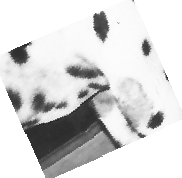

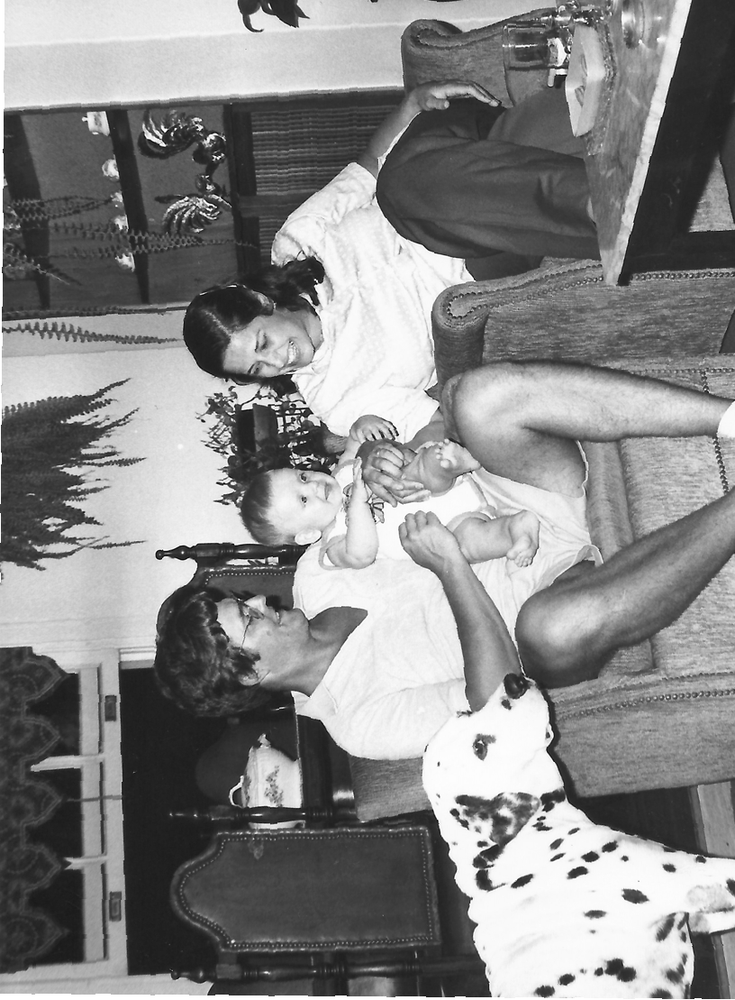

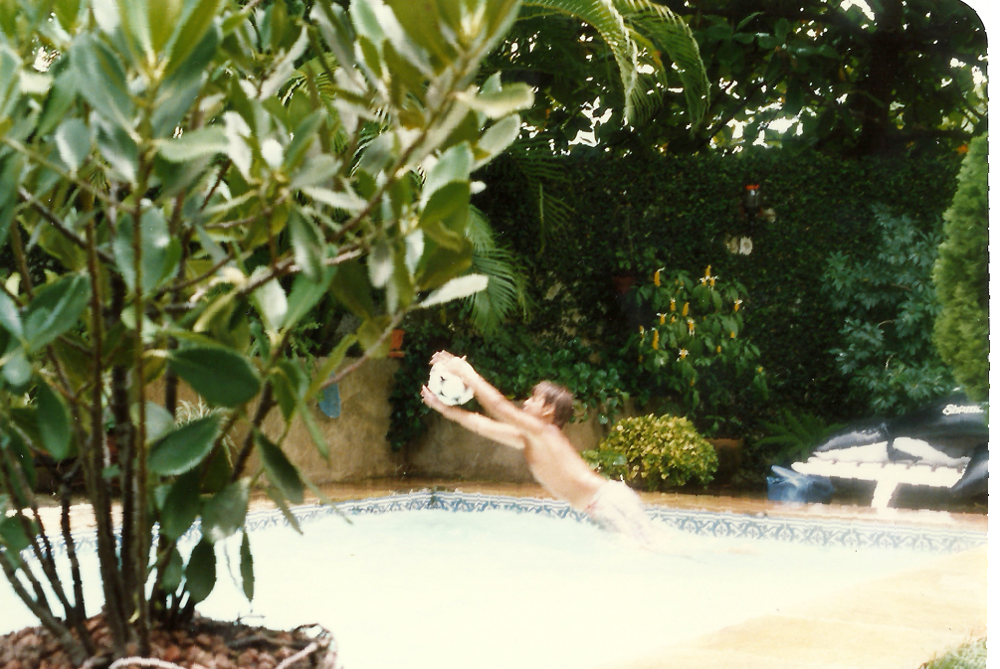

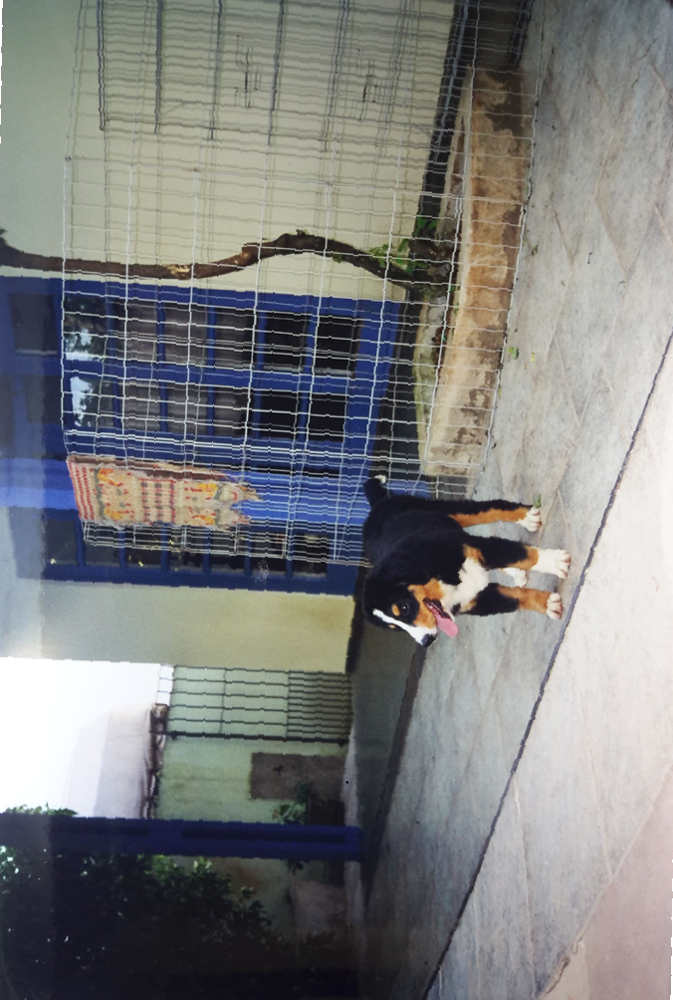

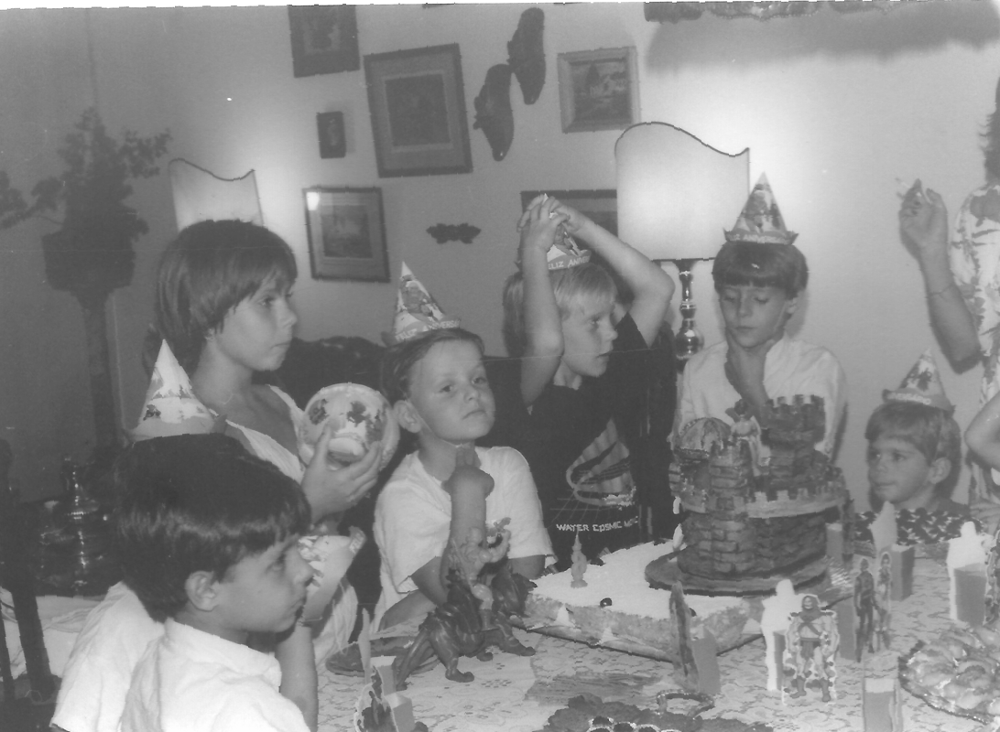

In [270]:
for i, img in enumerate(cropped_photos):
    display(treat_img(img))

In [251]:
# def unskew_image(img):
#     img.save('tmp_img.jpg', 'JPEG')
#     image = cv2.imread("tmp_img.jpg") 
#     gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
#     # display(array_to_PIL(gray))
#     white_threshold = 253
#     # Create inked image: ink = black (0), background = white (255)
#     _, inked_image = cv2.threshold(gray, white_threshold, 255, cv2.THRESH_BINARY)
#     # display(array_to_PIL(inked_image))
#     blurred = cv2.GaussianBlur(inked_image, (5, 5), 0)
#     _, spread_ink = cv2.threshold(blurred, 240, 255, cv2.THRESH_BINARY)
#     # display(array_to_PIL(spread_ink))
#     edges = cv2.Canny(spread_ink, 50, 150, apertureSize=7)
#     # display(array_to_PIL(edges))
#     # Find contours
#     contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
#     # Get the largest contour (likely the photo border)
#     largest = max(contours, key=cv2.contourArea)
#     rect = cv2.minAreaRect(largest)  
#     angle = rect[-1]
#     img.rotate(90-angle)
#     cropped_photos, bounding_boxes = extract_photos_from_canvas(img.rotate(90-angle), buffer=0)
#     return cropped_photos[0]


# # print(angle)
# # display(array_to_PIL(rotate_image(img2,angle)))

# # display(img.rotate(90-angle))

# # def estimate_rotation_fft(image):
# #     f = np.fft.fft2(image)
# #     fshift = np.fft.fftshift(f)
# #     magnitude_spectrum = 20 * np.log(np.abs(fshift))

# #     # Use cv2 methods on the magnitude spectrum
# #     mag = np.asarray(magnitude_spectrum, dtype=np.uint8)
# #     edges = cv2.Canny(mag, 50, 150)
# #     lines = cv2.HoughLines(edges, 1, np.pi/180, 100)

# #     angles = [np.rad2deg(theta) for rho, theta in lines[:,0]]
# #     return np.median(angles)

# # new_angle = estimate_rotation_fft(img2)

# # print(new_angle)
# # display(img.rotate(90-new_angle))

In [252]:
# # Assume img_test is your preprocessed binary image (e.g., inked_image or thresholded)
# contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# max_area = 0
# max_rect = None

# # Loop over all contours
# for contour in contours:
#     if len(contour) < 5:  # minAreaRect needs at least 5 points sometimes
#         continue

#     rect = cv2.minAreaRect(contour)
#     (center, (w, h), angle) = rect
#     area = w * h

#     if area > max_area:
#         max_area = area
#         max_rect = rect

# # Get corners of the largest rectangle
# if max_rect:
#     box = cv2.boxPoints(max_rect)
#     box = box.astype(np.intp)

#     # Draw on the original image (not the binary one)
#     # Check the number of channels
#     if len(img_test.shape) == 2:  # grayscale image
#         output_image = cv2.cvtColor(img_test, cv2.COLOR_GRAY2BGR)
#     else:
#         output_image = img_test.copy()

#     # Draw rectangle
#     cv2.drawContours(output_image, [box], 0, (0, 255, 0), 2)

#     # Draw corner circles
#     for x, y in box:
#         cv2.circle(output_image, (x, y), 5, (0, 255, 0), -1)

# else:
#     print("No valid rectangles found.")

# display(array_to_PIL(output_image))

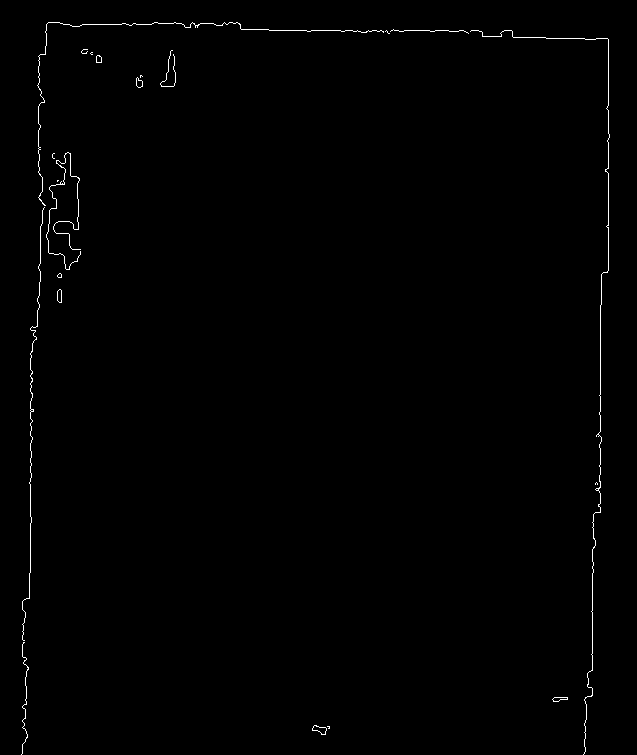

In [92]:
array_to_PIL(edges)

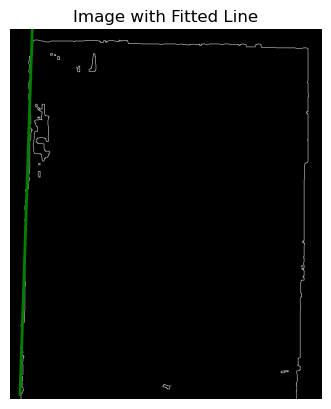

(-29.81936516485568, 1.920708745677345)

In [219]:
m,b = get_slice_poly(np.array(edges),s="L",debug=False)
a = angle_from_line(m,"v")

plot_image_with_line(np.array(edges),m,b,x0=45)
m,a

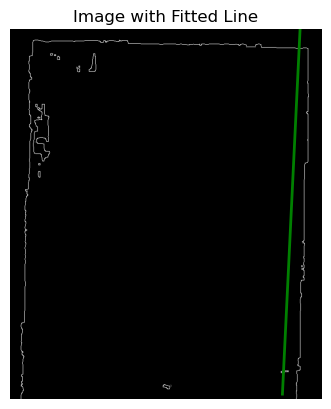

(-20.681681556200484, 2.76820775147236)

In [220]:
m,b = get_slice_poly(np.array(edges),s="R",debug=False)
a = angle_from_line(m,"v")
plot_image_with_line(np.array(edges),m,b,x0=edges.shape[1]-45)
m,a

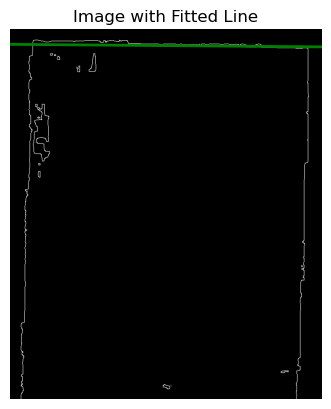

(0.008153050746838182, 0.4671250478510581)

In [221]:
m,b = get_slice_poly(np.array(edges),s="T",debug=False)
a = angle_from_line(m,"h")
plot_image_with_line(np.array(edges),m,b,y0=30)
m,a

In [222]:
m,b = get_slice_poly(np.array(edges),s="B",debug=False)
a = angle_from_line(m,"h")
plot_image_with_line(np.array(edges),m,b,y0=edges.shape[0]-30)
m,a

C:\Users\johnm\AppData\Local\Temp\ipykernel_25800\3184957344.py:194: UserWarning: No line found (not enough white pixels in scan).
  warnings.warn("No line found (not enough white pixels in scan).")
C:\Users\johnm\AppData\Local\Temp\ipykernel_25800\3184957344.py:203: UserWarning: m cannot be 0 (no slope)
  warnings.warn("m cannot be 0 (no slope)")
C:\Users\johnm\AppData\Local\Temp\ipykernel_25800\3184957344.py:219: UserWarning: Cannot plot line with no slope
  warnings.warn("Cannot plot line with no slope")


(None, None)

In [230]:
tmpDf, a = get_avg_skew_angle(np.array(edges))

C:\Users\johnm\AppData\Local\Temp\ipykernel_25800\521717067.py:194: UserWarning: No line found (not enough white pixels in scan).
  warnings.warn("No line found (not enough white pixels in scan).")
C:\Users\johnm\AppData\Local\Temp\ipykernel_25800\521717067.py:203: UserWarning: m cannot be 0 (no slope)
  warnings.warn("m cannot be 0 (no slope)")


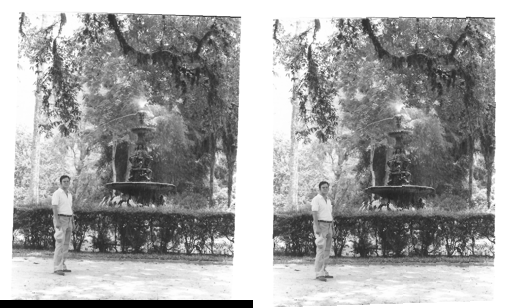

In [247]:
img_thumb = img.copy()
img_thumb.thumbnail((300,300))
img_thumb_r = img_thumb.rotate(a,expand=True, fillcolor='white')
new_width = img_thumb.width + img_thumb_r.width
new_height = max(img_thumb.height, img_thumb_r.height)
side_by_side = Image.new('RGB', (new_width, new_height), color=(0, 0, 0))
side_by_side.paste(img_thumb, (0, 0))
side_by_side.paste(img_thumb_r, (img_thumb.width, 0))
side_by_side

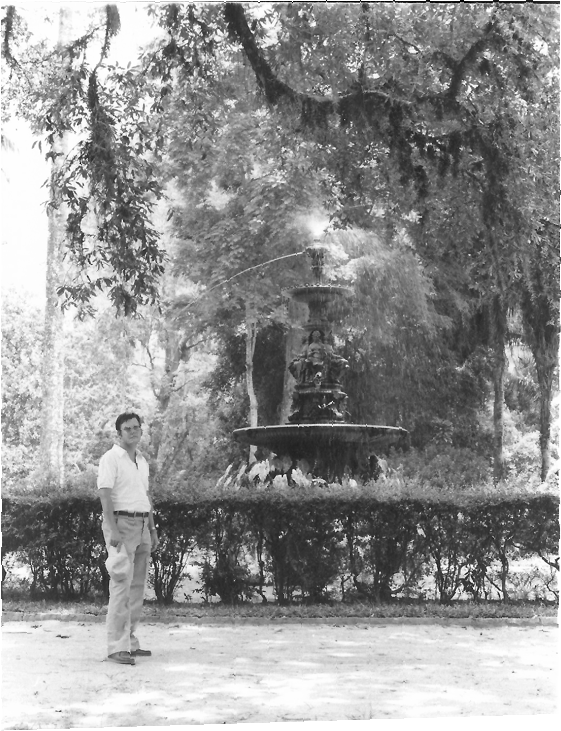

In [250]:
img_rotated = img.rotate(a,expand=True, fillcolor='white')
img_rotated = crop_white_borders(img_rotated)
img_rotated